# [Chapter 6] Exploring the nutrition data

[DSLC stages]: EDA

We examined and cleaned the nutrition data in the file `01_cleaning.qmd`. In this document, you will find the code for conducting an EDA of the nutrition data. This document is far from exhaustive and you are encouraged to add some sections to conduct your own explorations of this data.


In each code file that uses the cleaned version of the data, it is good practice to load in the original "raw" (uncleaned) data and then clean it using the cleaning function you wrote. It is often helpful to keep a copy of the original uncleaned data in your environment too. 

First we will load in the libraries that we will use. Note that if you don't have `superheat`, we recommend downloading it from github using the devtools code that is commented out, rather than from CRAN (the CRAN version is outdated). 


In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
from scipy.cluster import hierarchy

pd.set_option('display.max_columns', None)


Next, we will import the cleaning and pre-processing functions that we wrote. 


In [2]:
from functions.preprocess_food_data import preprocess_food_data
from functions.clean_food_data import clean_food_data


And load in the raw data objects and clean them. We will create a cleaned version of both the FNDDS and Legacy datasets. We will also pre-process each dataset, by log-transforming and SD-scaling them (we won't center them). 

In [3]:
nutrient_amount = pd.read_csv("../data/food_nutrient.csv")
food_name = pd.read_csv("../data/food.csv")
nutrient_name = pd.read_csv("../data/nutrient_name.csv")

# create the clean dataset
food_fndds = clean_food_data(nutrient_amount_data=nutrient_amount, 
                             food_name_data=food_name, 
                             nutrient_name_data=nutrient_name, 
                             select_data_type="survey_fndds_food")

# Preprocess the FNDDS data
food_fndds_log_scaled = preprocess_food_data(food_fndds, 
                                             log_transform=True,
                                             center=False,
                                             scale=True,
                                             remove_fat=False)
# Clean the Legacy data
food_legacy = clean_food_data(nutrient_amount_data = nutrient_amount, 
                              food_name_data=food_name,
                              nutrient_name_data=nutrient_name, 
                              select_data_type="sr_legacy_food")
# Preprocess the Legacy data
food_legacy_log_scaled = preprocess_food_data(food_legacy,
                                              log_transform=True,
                                              center=False,
                                              scale=True,
                                              remove_fat=False)


/var/folders/7j/0rhz18qs4d9dzfjkz9p2xlcr0000gn/T/ipykernel_2997/1982870890.py:1: DtypeWarning: Columns (9) have mixed types. Specify dtype option on import or set low_memory=False.
  nutrient_amount = pd.read_csv("../data/food_nutrient.csv")


## High-level summary of the data

Here are some histograms of the nutrients. 

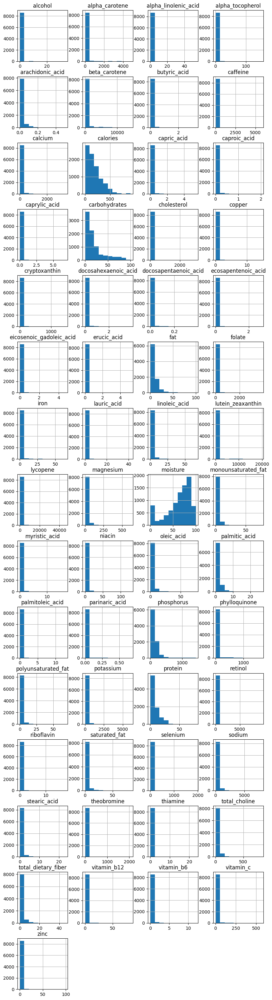

In [4]:
fig = food_fndds.hist(bins=10, figsize=(10, 40), layout=(15, 4))

The distributions of each of these nutrients is fairly skewed. 

After log-transforming and standardizing these nutrients however, some of them look substantially more symmetrical. Some of the nutrients that were particularly skewed are still fairly skewed.


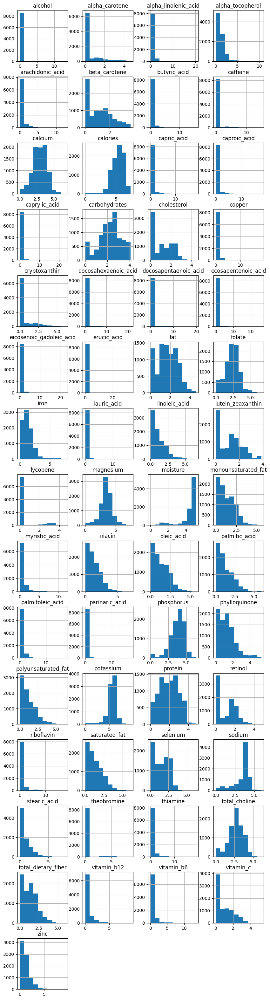

In [5]:
fig = food_fndds_log_scaled.hist(bins=10, figsize=(10, 40), layout=(15, 4))

The following table shows a random sample of 15 food items.  

In [6]:
food_fndds.sample(15, random_state=3243581).sort_index()

,alcohol,alpha_carotene,alpha_linolenic_acid,alpha_tocopherol,arachidonic_acid,beta_carotene,butyric_acid,caffeine,calcium,calories,capric_acid,caproic_acid,caprylic_acid,carbohydrates,cholesterol,copper,cryptoxanthin,docosahexaenoic_acid,docosapentaenoic_acid,ecosapentenoic_acid,eicosenoic_gadoleic_acid,erucic_acid,fat,folate,iron,lauric_acid,linoleic_acid,lutein_zeaxanthin,lycopene,magnesium,moisture,monounsaturated_fat,myristic_acid,niacin,oleic_acid,palmitic_acid,palmitoleic_acid,parinaric_acid,phosphorus,phylloquinone,polyunsaturated_fat,potassium,protein,retinol,riboflavin,saturated_fat,selenium,sodium,stearic_acid,theobromine,thiamine,total_choline,total_dietary_fiber,vitamin_b12,vitamin_b6,vitamin_c,zinc
description,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
"Basil, raw",0.0,0.0,0.316,0.80,0.000,3142.0,0.000,0.0,177.0,23.0,0.000,0.000,0.000,2.65,0.0,0.385,46.0,0.000,0.000,0.000,0.000,0.000,0.64,68.0,3.17,0.000,0.073,5650.0,0.0,64.0,92.06,0.088,0.000,0.902,0.088,0.036,0.000,0.000,56.0,414.8,0.389,295.0,3.15,0.0,0.076,0.041,0.3,4.0,0.005,0.0,0.034,11.4,1.6,0.00,0.155,18.0,0.81
"Beans, lima and corn, cooked, fat added in cooking, NS as to type of fat",0.0,9.0,0.099,0.44,0.000,88.0,0.052,0.0,15.0,107.0,0.042,0.032,0.019,19.31,3.0,0.058,59.0,0.000,0.000,0.000,0.004,0.000,2.81,32.0,0.86,0.044,0.649,331.0,0.0,22.0,72.35,0.715,0.123,1.264,0.695,0.565,0.016,0.000,68.0,3.8,0.747,257.0,4.18,19.0,0.067,1.120,0.6,282.0,0.227,0.0,0.072,28.6,4.0,0.00,0.132,5.7,0.44
"Broccoflower, cooked, fat not added in cooking",0.0,0.0,0.106,0.04,0.000,85.0,0.000,0.0,32.0,32.0,0.000,0.000,0.000,6.24,0.0,0.040,0.0,0.000,0.000,0.000,0.001,0.001,0.31,41.0,0.72,0.000,0.030,39.0,0.0,19.0,88.94,0.030,0.000,0.677,0.024,0.039,0.004,0.000,57.0,20.7,0.136,276.0,3.02,0.0,0.099,0.043,0.8,254.0,0.004,0.0,0.070,58.4,3.3,0.00,0.205,72.2,0.63
"Cake, Boston cream pie",0.0,0.0,0.055,0.15,0.010,2.0,0.020,0.0,23.0,252.0,0.005,0.012,0.007,42.90,37.0,0.042,1.0,0.003,0.000,0.000,0.002,0.000,8.50,14.0,0.38,0.013,0.941,27.0,0.0,6.0,45.40,4.544,0.093,0.191,4.504,1.265,0.031,0.000,49.0,3.1,1.009,39.0,2.40,23.0,0.270,2.445,4.1,254.0,1.006,6.0,0.408,17.4,1.4,0.16,0.026,0.2,0.16
"Fruit dessert, baby food, NS as to strained or junior",0.0,2.0,0.000,0.29,0.000,64.0,0.000,0.0,9.0,61.0,0.000,0.000,0.000,16.60,0.0,0.030,27.0,0.000,0.000,0.000,0.000,0.000,0.00,4.0,0.22,0.000,0.000,43.0,0.0,5.0,82.80,0.000,0.000,0.144,0.000,0.000,0.000,0.000,8.0,1.5,0.000,94.0,0.30,0.0,0.010,0.000,0.4,0.0,0.000,0.0,0.019,4.5,0.6,0.00,0.035,2.8,0.04
"Ham or pork and rice, no sauce",0.0,0.0,0.169,0.42,0.007,0.0,0.000,0.0,10.0,142.0,0.002,0.000,0.000,16.80,14.0,0.054,0.0,0.000,0.000,0.000,0.029,0.000,4.99,35.0,0.92,0.002,1.275,0.0,0.0,12.0,70.31,2.124,0.023,1.935,2.021,0.732,0.067,0.000,70.0,3.7,1.459,97.0,6.73,0.0,0.067,1.098,10.8,308.0,0.305,0.0,0.279,18.9,0.2,0.13,0.154,0.1,0.75
"Iced Coffee, pre-lightened and pre-sweetened",0.0,0.0,0.004,0.01,0.002,2.0,0.022,27.0,7.0,30.0,0.026,0.018,0.011,4.91,3.0,0.004,0.0,0.000,0.001,0.000,0.002,0.000,1.10,1.0,0.01,0.030,0.038,0.0,0.0,3.0,93.36,0.268,0.096,0.136,0.225,0.263,0.019,0.000,7.0,0.2,0.046,42.0,0.25,10.0,0.064,0.582,0.3,6.0,0.098,0.0,0.011,2.7,0.0,0.01,0.003,0.0,0.03
"Infant formula, powder, made with baby water (Enfamil Infant)",0.0,0.0,0.057,0.89,0.019,0.0,0.000,0.0,50.0,66.0,0.038,0.009,0.057,7.38,0.0,0.049,0.0,0.009,0.000,0.000,0.009,0.009,3.49,10.0,1.19,0.307,0.589,0.0,0.0,5.0,87.28,1.292,0.142,0.647,1.264,0.748,0.009,0.000,28.0,6.0,0.675,71.0,1.40,59.0,0.093,1.444,1.9,18.0,0.143,0.0,0.053,15.7,0.0,0.20,0.040,8.0,0.66
"Milk shake, bottled, chocolate",0.0,0.0,0.028,0.25,0.007,0.0,0.194,5.0,115.0,150.0,0.151,0.149,0.065,20.36,23.0,0.177,0.0,0.000,0.003,0.000,0.004,0.000,6.66,1.0,0.73,0.171,0.265,1.0,0.0,23.0,68.32,1.841,0.582,0.252,1.666,1.763,0.114,0.012,111.0,0.4,0.318,193.0,3.70,89.0,0.652,4.044,3.4,80.0,0.864,41.0,0.027,27.0,1.6,0.22,0.061,0.0,0.70


Next, let's look at a heatmap of the entire dataset. There are clearly some columns that are similar, but arranged alphabetically, it is very hard to tease apart what they are.

In [7]:
food_heatmap = (
    food_fndds
        .drop(columns=["caffeine", "moisture", "alcohol", "theobromine"])
        # standardize each column
        .apply(lambda x: (x - x.mean()) / x.std(), axis=0)
        # remove index
        .reset_index(drop=True)
)
# reverse the order of the rows just so that it matches the ggplot2 R version shown in the book
px.imshow(food_heatmap.iloc[::-1].reset_index(drop=True), 
          # choose a color scale that is just black for all but very small values
          color_continuous_scale = ["#FFFFFF", "#7F7F7F", "#000000", "#000000", "#000000", "#000000", 
                                    "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                    "#000000", "#000000", "#000000", "#000000", "#000000", "#000000", 
                                    "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                    "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                    "#000000", "#000000", "#000000", "#000000", "#000000", "#000000"])



Let's create an explanatory version of this heatmap that arranges the nutrient columns so that similar nutrients are grouped together. We made these grouping decisions based on our own domain knowledge as well as an initial version of this heatmap. We will also arrange the food items/rows using a "clustering" algorithm that we will introduce in Chapter 8. 

In [8]:
# define a vector for manually arranging the nutrient columns into nutrient groups
nutrient_order = [
  # vitamins
  "vitamin_b6", "alpha_tocopherol",  "riboflavin", "thiamine", "folate", "niacin", 
  "vitamin_c", "vitamin_b12", "retinol",  "beta_carotene", "lutein_zeaxanthin", 
  "phylloquinone", "lycopene", "cryptoxanthin", "alpha_carotene",
  #major minerals
  "sodium", "potassium", "calcium", "phosphorus", "magnesium", "total_choline",
  # trace minerals
  "iron", "zinc", "selenium", "copper",
  # carbohydrates
  "carbohydrates", "total_dietary_fiber",
  # fats
  "fat", "saturated_fat", "monounsaturated_fat", "polyunsaturated_fat", 
  "palmitic_acid", "stearic_acid", "oleic_acid", "linoleic_acid", 
  "arachidonic_acid", "palmitoleic_acid", "alpha_linolenic_acid", 
  "eicosenoic_gadoleic_acid", "cholesterol", "butyric_acid", "caproic_acid", 
  "caprylic_acid", "capric_acid", "myristic_acid", "lauric_acid", "docosapentaenoic_acid", 
  "docosahexaenoic_acid",  "parinaric_acid", "ecosapentenoic_acid", "erucic_acid", 
  # calories
  "calories",
  # protein
  "protein"
]

In [9]:
# do a fancy clustering to decide the order of the rows/food items
# you'll learn this in chapter 8
hierarchical_cluster = hierarchy.ward(food_heatmap)
hierarchical_cluster_order = hierarchy.leaves_list(hierarchical_cluster)

# rearrange the rows in the food dataset in order of the hierarchical clusters and the columns to match the nutrient groups
food_heatmap_cluster_ordered = (
    food_heatmap.loc[hierarchical_cluster_order, nutrient_order]
        # reverse the order of the rows to match the R/book version
        .iloc[::-1].reset_index(drop=True)
)
# create a heatmap
food_heatmap_fig = px.imshow(food_heatmap_cluster_ordered,
                # choose a color scale that is just black for all but very small values
                color_continuous_scale = ["#FFFFFF", "#7F7F7F", "#000000", "#000000", "#000000", "#000000", 
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000", 
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000"])
# add boxes around the columns for each nutrient group
food_heatmap_fig.add_vrect(x0=-0.5, x1=14.5)
food_heatmap_fig.add_vrect(x0=14.5, x1=20.5)
food_heatmap_fig.add_vrect(x0=20.5, x1=24.5)
food_heatmap_fig.add_vrect(x0=24.5, x1=26.5)
food_heatmap_fig.add_vrect(x0=24.5, x1=50.5)
food_heatmap_fig.add_vrect(x0=50.5, x1=51.5)
food_heatmap_fig.add_vrect(x0=51.5, x1=52.5)



### PCS evaluation of heatmap exploration

#### Predictability

Let's see if these same patterns exist in the Legacy food dataset. Below, we recreate the heatmap using the Legacy dataset.

In [10]:
food_legacy_heatmap = (
    food_legacy.fillna(food_legacy_log_scaled.mean())
        .drop(columns=["caffeine", "moisture", "alcohol", "theobromine"])
        # standardize each column
        .apply(lambda x: (x - x.mean()) / x.std(), axis=0)
        # remove index
        .reset_index(drop=True)
)

In [11]:
# do a fancy clustering to decide the order of the rows/food items
# you'll learn this in chapter 8
hierarchical_cluster_legacy = hierarchy.ward(food_legacy_heatmap.fillna(food_legacy_heatmap.mean()))
hierarchical_cluster_legacy_order = hierarchy.leaves_list(hierarchical_cluster_legacy)

# rearrange the rows in the food dataset in order of the hierarchical clusters and the columns to match the nutrient groups
food_legacy_heatmap_cluster_ordered = (
    food_legacy_heatmap.loc[hierarchical_cluster_legacy_order, nutrient_order]
        # reverse the order of the rows to match the R/book version
        .iloc[::-1].reset_index(drop=True)
)
# create a heatmap
food_legacy_heatmap_fig = px.imshow(food_legacy_heatmap_cluster_ordered,
                # choose a color scale that is just black for all but very small values
                color_continuous_scale = ["#FFFFFF", "#7F7F7F", "#000000", "#000000", "#000000", "#000000", 
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000", 
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000"], )
# add boxes around the columns for each nutrient group
food_legacy_heatmap_fig.add_vrect(x0=-0.5, x1=14.5)
food_legacy_heatmap_fig.add_vrect(x0=14.5, x1=20.5)
food_legacy_heatmap_fig.add_vrect(x0=20.5, x1=24.5)
food_legacy_heatmap_fig.add_vrect(x0=24.5, x1=26.5)
food_legacy_heatmap_fig.add_vrect(x0=24.5, x1=50.5)
food_legacy_heatmap_fig.add_vrect(x0=50.5, x1=51.5)
food_legacy_heatmap_fig.add_vrect(x0=51.5, x1=52.5)


Since the food items between the FNDDS and Legacy datasets are different, we don't expect to see the exact same patterns, but we do see that columns that had similar patterns in the FNDDS dataset also seem to have similar patterns in the Legacy dataset.


#### Stability to transformation judgment call

Let's investigate the stability of this heatmap result to the judgment call of log-transforming the data (the original version was scaled and centered, but not log-transformed).

When we use the *log-transformed* scaled and centered data, the trends are fairly similar. 

In [12]:
# do a fancy clustering to decide the order of the rows/food items
# you'll learn this in chapter 8
food_log_scaled_heatmap = (
    food_fndds_log_scaled
        .drop(columns=["caffeine", "moisture", "alcohol", "theobromine"])
        # standardize each column
        .apply(lambda x: x - x.mean(), axis=0)
        # remove index
        .reset_index(drop=True)
)

hierarchical_cluster_log_scaled = hierarchy.ward(food_log_scaled_heatmap)
hierarchical_cluster_log_scaled_order = hierarchy.leaves_list(hierarchical_cluster_log_scaled)

# rearrange the rows in the food dataset in order of the hierarchical clusters and the columns to match the nutrient groups
food_log_scaled_heatmap_cluster_ordered = (
    food_heatmap.loc[hierarchical_cluster_log_scaled_order, nutrient_order]
        .reset_index(drop=True)
)
# create a heatmap
food_log_scaled_heatmap_fig = px.imshow(food_log_scaled_heatmap_cluster_ordered,
                # choose a color scale that is just black for all but very small values
                color_continuous_scale = ["#FFFFFF", "#7F7F7F", "#000000", "#000000", "#000000", "#000000", 
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000", 
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000",
                                          "#000000", "#000000", "#000000", "#000000", "#000000", "#000000"])
# add boxes around the columns for each nutrient group
food_log_scaled_heatmap_fig.add_vrect(x0=-0.5, x1=14.5)
food_log_scaled_heatmap_fig.add_vrect(x0=14.5, x1=20.5)
food_log_scaled_heatmap_fig.add_vrect(x0=20.5, x1=24.5)
food_log_scaled_heatmap_fig.add_vrect(x0=24.5, x1=26.5)
food_log_scaled_heatmap_fig.add_vrect(x0=24.5, x1=50.5)
food_log_scaled_heatmap_fig.add_vrect(x0=50.5, x1=51.5)
food_log_scaled_heatmap_fig.add_vrect(x0=51.5, x1=52.5)



## Correlation exploration

Prompted by the heatmaps above, we next ask *which nutrient variables are correlated with one another*. 

The heatmap below displays the *correlation matrix* of the nutrients. 

It is even clearer from this figure that there are some groups of highly correlated nutrients.


In [17]:
# compute the correlation matrix between the nutrients (columns)
food_fndds_cor = food_fndds.drop(columns=["caffeine", "moisture", "alcohol", "theobromine"]).corr()

# use hierarchical clustering to identify a reasonable ordering of the variables
hierarchical_cluster_nutrients = hierarchy.linkage(food_fndds_cor, method="complete")
hierarchical_cluster_nutrients_order = hierarchy.leaves_list(hierarchical_cluster_nutrients)

px.imshow(food_fndds_cor.iloc[hierarchical_cluster_nutrients_order, hierarchical_cluster_nutrients_order], 
          color_continuous_scale=["#F6AE2D", "white", "#18678B"], color_continuous_midpoint=0, width=1200, height=1200)



The question is, how similar are these groups to the nutrient groups that we identified in the previous section?



### PCS evaluations of correlation matrix


#### Predictability

Let's see if the same relationships hold in the Legacy food dataset. This time, however, rather than keeping rows with missing values, we remove them for now since correlations can't be computed for data with missing values. Note that this may introduce bias in the data, but for now we won't worry too much about it (but we will be aware of it).

The groupings seem to be very clear in this Legacy dataset too. 


In [18]:
# compute the correlation matrix between the nutrients (columns)
food_legacy_cor = (
    food_legacy[food_legacy.columns.intersection(food_fndds.columns)]
        .drop(columns=["caffeine", "moisture", "alcohol", "theobromine"])
        # fill missing values with mean values
        .fillna(food_legacy_heatmap.mean())
        .corr()
)

In [19]:
# use hierarchical clustering to identify a reasonable ordering of the variables
hierarchical_cluster_legacy_nutrients = hierarchy.linkage(food_legacy_cor, method="complete")
hierarchical_cluster_legacy_nutrients_order = hierarchy.leaves_list(hierarchical_cluster_legacy_nutrients)

px.imshow(food_legacy_cor.iloc[hierarchical_cluster_legacy_nutrients_order, hierarchical_cluster_legacy_nutrients_order], 
          height=1000, 
          color_continuous_scale=["#F6AE2D", "white", "#18678B"], color_continuous_midpoint=0)



#### Stability to visualization judgment calls

As a quick stability evaluation, we will arrange the columns and rows of the correlation matrix in the same order as the original heatmaps with our manual nutrient ordering

In [20]:
px.imshow(food_fndds_cor.loc[nutrient_order, nutrient_order], 
          height=1000, 
          color_continuous_scale=["#F6AE2D", "white", "#18678B"], color_continuous_midpoint=0)



There are still some very clear nutrient groupings in the heatmap when the nutrients are ordered based on our manual ordering defined above.


#### Stability to pre-processing judgment call


The correlations are generally *larger* after log-transforming the nutrient data. The groupings are still there but are a little bit more merged together, with the exception of the vitamins that still seem fairly distinct. 

In [21]:
# compute the correlation matrix between the nutrients (columns)
food_fndds_log_scaled_cor = food_fndds_log_scaled.drop(columns=["caffeine", "moisture", "alcohol", "theobromine"]).corr()

# use hierarchical clustering to identify a reasonable ordering of the variables
hierarchical_cluster_log_scaled_nutrients = hierarchy.linkage(food_fndds_log_scaled_cor, method="complete")
hierarchical_cluster_log_scaled_nutrients_order = hierarchy.leaves_list(hierarchical_cluster_log_scaled_nutrients)

px.imshow(food_fndds_log_scaled_cor.iloc[hierarchical_cluster_log_scaled_nutrients_order, hierarchical_cluster_log_scaled_nutrients_order], 
          height=1000, 
          color_continuous_scale=["#F6AE2D", "white", "#18678B"], color_continuous_midpoint=0)



## Defining nutrient groups


Based on these plots and our own nutrient domain knowledge, we will define the following groups of nutrients:



1. **Vitamins**: vitamin C, vitamin B6, vitamin B12, riboflavin, thiamine, folate, niacin, beta carotene, alpha carotene, lutein zeaxanthin, phylloquinone, alpha tocopherol, retinol, lycopene, cryptoxanthin

1. **Fats**: fat, saturated fat, monounsaturated fat, polyunsaturated fat, cholesterol, and all of the fatty acids 

1. **Major minerals**: sodium, potassium, calcium, phosphorus, magnesium, total choline

1. **Trace minerals**: iron, zinc, selenium, copper

1. **Carbohydrates**: carbohydrates, total dietary fiber

1. **Calories**: calories

1. **Protein**: protein


We chose to ignore the variables "moisture", "alcohol", "caffeine", and "theobromine", since we deemed these not particularly important for making nutritional dietary choices.

Note that these groupings are very clearly a *judgment call*, and we could certainly have defined them differently!




## Exploring the relationship between the food items



The above explorations gave us a vague sense of the relationships between the nutrients (we will try to formalize this in the PCA analysis file), but we don't yet have a sense of the food items themselves.

One way to explore the food items might be to take two nutrient variables (such as sodium and potassium) and visualize the food items in the space defined by these food items.

The points in the sodium-potassium scatterplot below clearly exhibit a large amount of overlap (despite adding transparency), but adding the text of a few food items helps tease apart some relationships in the food items. For instance, it seems that many cheese-related items (high in sodium, moderate in potassium) and fish-related food items (high in both sodium and potassium) are grouped close together. 

We are visualizing the log-transformed standardized data because the points are more spread out in this transformed space and so the trends are slightly easier to pick out.

In [22]:
px.scatter(food_fndds_log_scaled, x="sodium", y="potassium", 
           opacity=0.2, 
           hover_name=food_fndds_log_scaled.index)


Let's look at a few other pairs of variables too.

When we compare fat and vitamin C values, we see groups of fruits/vegetables (high in vitamin C, low in fat), groups of cereals (high in vitamin C and medium in fat), and groups of milk products (low in vitamin C and low in fat - probably these are mostly "fat free" milk products) standing out. 

In [23]:
px.scatter(food_fndds_log_scaled, x="fat", y="vitamin_c", 
           opacity=0.2, 
           hover_name=food_fndds_log_scaled.index)


When we compare alpha carotene and protein, we see meats stand out as high in both, and milk products stand out as notably low in alpha carotene (but varied in protein). 

In [24]:
px.scatter(food_fndds_log_scaled, x="alpha_carotene", y="protein", 
           opacity=0.2, 
           hover_name=food_fndds_log_scaled.index)


## Comparing the FNDDS and Legacy data

If we're going to use the SR legacy food dataset for conducting predictability assessments, we should explicitly compare this dataset to the FNDDS dataset.

A simple check is to compare the distributions of various nutrients. To compare the distributions of protein, fat, and sodium, we use side-by-side boxplots. Overall, the distributions look fairly similar, but are clearly not identical.

These differences could be a difference in the *way* the nutrients are measured, or it could be a difference in the types of food items that are included in each of the datasets.

In [ ]:
# identify the variables that are common to both datasets
common_vars = food_fndds.columns.intersection(food_legacy.columns)
food_fndds_common = food_fndds.loc[:, common_vars]
food_fndds_common["dataset"] = "fndds"
food_legacy_common = food_legacy.loc[:, common_vars]
food_legacy_common["dataset"] = "legacy"
# concatenate both datasets together, by row
food_common = pd.concat([food_fndds_common, food_legacy_common])


In [33]:
food_common.head()

,alcohol,alpha_carotene,alpha_linolenic_acid,alpha_tocopherol,arachidonic_acid,beta_carotene,butyric_acid,caffeine,calcium,calories,capric_acid,caproic_acid,caprylic_acid,carbohydrates,cholesterol,copper,cryptoxanthin,docosahexaenoic_acid,docosapentaenoic_acid,ecosapentenoic_acid,eicosenoic_gadoleic_acid,erucic_acid,fat,folate,iron,lauric_acid,linoleic_acid,lutein_zeaxanthin,lycopene,magnesium,moisture,monounsaturated_fat,myristic_acid,niacin,oleic_acid,palmitic_acid,palmitoleic_acid,parinaric_acid,phosphorus,phylloquinone,polyunsaturated_fat,potassium,protein,retinol,riboflavin,saturated_fat,selenium,sodium,stearic_acid,theobromine,thiamine,total_choline,total_dietary_fiber,vitamin_b12,vitamin_b6,vitamin_c,zinc,dataset
description,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
"Milk, human",0.0,0.0,0.052,0.08,0.026,7.0,0.000,0.0,32.0,70.0,0.063,0.000,0.000,6.89,14.0,0.052,0.0,0.0,0.0,0.0,0.040,0.0,4.38,5.0,0.03,0.256,0.374,0.0,0.0,3.0,87.50,1.658,0.321,0.177,1.475,0.919,0.129,0.0,14.0,0.3,0.497,51.0,1.03,60.0,0.036,2.009,1.8,17.0,0.293,0.0,0.014,16.0,0.0,0.05,0.011,5.0,0.17,fndds
"Milk, NFS",0.0,0.0,0.030,0.04,0.000,4.0,0.059,0.0,119.0,51.0,0.049,0.044,0.036,4.85,8.0,0.014,0.0,0.0,0.0,0.0,0.001,0.0,2.04,5.0,0.03,0.052,0.070,0.0,0.0,11.0,89.13,0.541,0.185,0.091,0.517,0.548,0.013,0.0,91.0,0.2,0.102,141.0,3.27,53.0,0.179,1.232,3.1,45.0,0.240,0.0,0.039,15.8,0.0,0.49,0.037,0.1,0.42,fndds
"Milk, whole",0.0,0.0,0.075,0.07,0.000,7.0,0.075,0.0,113.0,61.0,0.075,0.075,0.075,4.80,10.0,0.025,0.0,0.0,0.0,0.0,0.000,0.0,3.25,5.0,0.03,0.077,0.120,0.0,0.0,10.0,88.13,0.812,0.297,0.089,0.812,0.829,0.000,0.0,84.0,0.3,0.195,132.0,3.15,45.0,0.169,1.865,3.7,43.0,0.365,0.0,0.046,14.3,0.0,0.45,0.036,0.0,0.37,fndds
"Milk, low sodium, whole",0.0,0.0,0.050,0.08,0.000,7.0,0.112,0.0,101.0,61.0,0.087,0.066,0.039,4.46,14.0,0.010,0.0,0.0,0.0,0.0,0.000,0.0,3.46,5.0,0.05,0.097,0.078,0.0,0.0,5.0,88.20,0.999,0.348,0.043,0.870,0.910,0.077,0.0,86.0,0.3,0.128,253.0,3.10,28.0,0.105,2.154,2.0,3.0,0.419,0.0,0.020,16.0,0.0,0.36,0.034,0.9,0.38,fndds
"Milk, calcium fortified, whole",0.0,0.0,0.075,0.07,0.000,7.0,0.075,0.0,113.0,61.0,0.075,0.075,0.075,4.80,10.0,0.025,0.0,0.0,0.0,0.0,0.000,0.0,3.25,5.0,0.03,0.077,0.120,0.0,0.0,10.0,88.13,0.812,0.297,0.089,0.812,0.829,0.000,0.0,84.0,0.3,0.195,132.0,3.15,45.0,0.169,1.865,3.7,43.0,0.365,0.0,0.046,14.3,0.0,0.45,0.036,0.0,0.37,fndds


In [26]:
px.box(food_common, x="dataset", y="protein", title="Protein")

In [27]:
px.box(food_common, x="dataset", y="fat", title= "Fat")

In [28]:
px.box(food_common, x="dataset", y="iron", title="Iron")

In [29]:
px.box(food_common, x="dataset", y="sodium", title="Sodium")


Let's also compare the nutrient values of a few specific food items. For instance, here are the nutrient values of various nonfat Greek yogurt.


In [30]:
yogurt_index = food_common.index.str.lower().str.contains(r'^(?=.*yogurt)(?=.*greek)(?=.*fat)(?=.*plain)(?=.*low)')
food_yogurt = food_common.iloc[yogurt_index,:][["dataset", "protein", "fat", "carbohydrates", "calories", "calcium", "sodium"]]
food_yogurt


,dataset,protein,fat,carbohydrates,calories,calcium,sodium
description,,,,,,,
"Yogurt, Greek, low fat milk, plain",fndds,9.95,1.92,3.94,73.0,115.0,34.0
"Yogurt, Greek, plain, lowfat",legacy,9.95,1.92,3.94,73.0,115.0,34.0


In [31]:
minestrone_index = food_common.index.str.lower().str.contains(r'^(?=.*soup)(?=.*minestrone)(?=.*can)')
food_minestrone = food_common.iloc[minestrone_index,:][["dataset", "protein", "fat", "carbohydrates", "calories", "calcium", "sodium"]]
food_minestrone


,dataset,protein,fat,carbohydrates,calories,calcium,sodium
description,,,,,,,
"Minestrone soup, reduced sodium, canned or ready-to-serve",fndds,2.00,0.80,9.00,50.0,20.0,215.0
"Minestrone soup, canned, prepared with water, or ready-to-serve",fndds,1.74,1.03,4.60,34.0,16.0,261.0
"Soup, minestrone, canned, condensed",legacy,3.48,2.05,9.17,68.0,28.0,516.0
"Soup, minestrone, canned, chunky, ready-to-serve",legacy,2.13,1.17,8.64,53.0,25.0,288.0
"Soup, minestrone, canned, prepared with equal volume water",legacy,1.77,1.04,4.66,34.0,14.0,254.0
"Soup, minestrone, canned, reduced sodium, ready-to-serve",legacy,2.00,0.80,9.00,50.0,20.0,215.0


In [32]:
pecan_pie_index = food_common.index.str.lower().str.contains(r'^(?=.*pecan)(?=.*pie)')
food_pecan_pie = food_common.iloc[pecan_pie_index,:][["dataset", "protein", "fat", "carbohydrates", "calories", "calcium", "sodium"]]
food_pecan_pie

,dataset,protein,fat,carbohydrates,calories,calcium,sodium
description,,,,,,,
"Pie, pecan",fndds,4.5,16.69,59.61,407.0,22.0,275.0
"Pie, pecan, individual size or tart",fndds,4.5,16.69,59.61,407.0,22.0,275.0
"Pie, pecan, prepared from recipe",legacy,4.9,22.20,52.20,412.0,32.0,262.0
"Pie, pecan, commercially prepared",legacy,4.5,16.69,59.61,407.0,22.0,275.0




Overall, since we would expect some differences in the food items that people might use our app on and the underlying data in any of these datasets, these differences across the different datasets feel in line with the differences we would expect from the future data that our users would be inputting into our app. 


We're going to stop here, but feel free to conduct any additional explorations that occur to you!